# Oct 23, 2025: demonstrate MCMC simulations and convergence

conda env: gt

In [1]:
from scipy.cluster.hierarchy import dendrogram
import numpy as np 
import os
import emcee
from scipy import stats 

# plotting
import matplotlib as mpl
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.cm import rainbow
from cycler import cycler
import matplotlib.colors as mcolors
import matplotlib.ticker as mticker
import matplotlib.cm as cm
import matplotlib.gridspec as gridspec

from scipy.stats import gaussian_kde
from mpl_toolkits.mplot3d import Axes3D  # enables 3D plotting

plt.rcParamsDefault['font.family'] = "sans-serif"
plt.rcParamsDefault['font.sans-serif'] = "Arial"
plt.rcParams['font.size'] = 14
plt.rcParams["errorbar.capsize"] = 0.5

import plotly.graph_objects as go
import colorcet as cc

# ignore user warnings
import warnings
warnings.filterwarnings("ignore") #, category=UserWarning)


In [2]:
def get_colorblind_palette(n=20):
    """Return a merged, deduplicated colorblind-safe palette from CUD, Seaborn, and extended sources."""
    base = [
        "#0072B2", "#D55E00", "#009E73", "#CC79A7",
        "#F0E442", "#56B4E9", "#E69F00", "#000000",
        "#999999", "#882255", "#44AA99", "#117733"
    ]
    
    new = [
        "#0173B2", "#DE8F05", "#029E73", "#D55E00",  # D55E00 already in base
        "#CC78BC", "#CA9161", "#FBAFE4", "#949494",
        "#ECE133", "#56B4E9"  # 56B4E9 already in base
    ]
    
    # Deduplicate while preserving order
    seen = set()
    full = base + new
    merged = []
    for color in full:
        if color.lower() not in seen:
            merged.append(color)
            seen.add(color.lower())
    
    return merged[:n]

def setup_mpl(fontsize=7):
    """Configure matplotlib for Illustrator export with Helvetica-style fonts and clean styles."""
    
    CUD_COLORS = get_colorblind_palette()
    
    mpl.rcParams.update({
        # Fonts and layout
        "font.family": "sans-serif",
        "font.sans-serif": ["Arial", "DejaVu Sans"],
        "font.size": fontsize,
        "axes.titlesize": fontsize,
        "axes.labelsize": fontsize,
        "xtick.labelsize": fontsize,
        "ytick.labelsize": fontsize,
        "legend.fontsize": fontsize,

        # Export settings
        "svg.fonttype": 'none',
        "pdf.fonttype": 42,
        "ps.fonttype": 42,
        "figure.dpi": 300,
        "savefig.dpi": 300,
        "text.usetex": False,

        # Axes and ticks
        "axes.linewidth": 0.5,
        "xtick.major.width": 0.5,
        "ytick.major.width": 0.5,
        "xtick.minor.width": 0.5,
        "ytick.minor.width": 0.5,
        "xtick.major.size": 2.5,
        "ytick.major.size": 2.5,

        # Lines
        "lines.linewidth": 1.0,

        # Default color cycle (Color Universal Design)
        "axes.prop_cycle": cycler('color', CUD_COLORS),
    })

    # mpl.rcParams["axes.prop_cycle"] = cycler('color', get_colorblind_palette())

In [3]:
setup_mpl(fontsize=7)
CUD_COLORS = get_colorblind_palette()

In [4]:
import seaborn as sns

In [5]:
class ARGS():
    pass

args = ARGS()

args.SEED = 100

log probability distributions: the actual solution landscape

In [6]:
def ln_prob_unimodal(coords):
    '''log prob of 2d gaussian'''
    x, y = coords
    # bivariate unit normal
    log_p = -0.5 * (x**2 + y**2) - np.log(2*np.pi)
    return log_p

In [7]:
def ln_prob_bimodal_convergent(coords):
    """
    Log-probability for a bimodal (convergent) landscape.
    A mixture of two *unequal* Gaussians that are relatively close.
    """
    x, y = coords
    
    # Define two different Gaussian peaks
    variance1 = 1.5**2
    inv_variance1 = 1.0 / variance1
    variance2 = 0.8**2
    inv_variance2 = 1.0 / variance2
    
    # --- Mode 1 ("Good" Mode, 70% probability) ---
    # This mode has a higher peak (lower variance)
    mu1_x, mu1_y = -2.0, 0
    # log(P(data | mode_1))
    log_p1 = -0.5 * ( ((x - mu1_x)**2 * inv_variance1) + ((y - mu1_y)**2 * inv_variance1) ) \
             - 0.5 * np.log(2 * np.pi * variance1)**2
    # log(P(mode_1)) + log(P(data | mode_1))
    log_p1_total = np.log(0.7) + log_p1 # 70% of the mixture

    # --- Mode 2 ("Bad" Mode, 30% probability) ---
    # This mode has a lower peak (higher variance)
    mu2_x, mu2_y = 2.0, 0
    # log(P(data | mode_2))
    log_p2 = -0.5 * ( ((x - mu2_x)**2 * inv_variance2) + ((y - mu2_y)**2 * inv_variance2) ) \
             - 0.5 * np.log(2 * np.pi * variance2)**2
    # log(P(mode_2)) + log(P(data | mode_2))
    log_p2_total = np.log(0.3) + log_p2 # 30% of the mixture

    # --- Combine them using logaddexp ---
    # This is the numerically stable way to compute:
    # log( P(mode_1)*P(data|mode_1) + P(mode_2)*P(data|mode_2) )
    log_p_final = np.logaddexp(log_p1_total, log_p2_total)
    
    # Handle -inf values for stability
#     log_p_final[~np.isfinite(log_p_final)] = -1e100
    return log_p_final

In [8]:
def ln_prob_bimodal_divergent(coords):
    """
    Log-probability for a bimodal (divergent) landscape.
    A mixture of two *unequal* Gaussians that are too far apart.
    """
    x, y = coords
    
    # Define two different Gaussian peaks
    variance1 = 0.5**2
    inv_variance1 = 1.0 / variance1
    variance2 = 0.8**2
    inv_variance2 = 1.0 / variance2
    
    # --- Mode 1 ("Good" Mode, 70% probability) ---
    mu1_x, mu1_y = -5.0, 0  # <-- MOVED FARTHER
    # log(P(data | mode_1))
    log_p1 = -0.5 * ( ((x - mu1_x)**2 * inv_variance1) + ((y - mu1_y)**2 * inv_variance1) ) \
             - 0.5 * np.log(2 * np.pi * variance1)**2
    # log(P(mode_1)) + log(P(data | mode_1))
    log_p1_total = np.log(0.7) + log_p1 # 70% of the mixture

    # --- Mode 2 ("Bad" Mode, 30% probability) ---
    mu2_x, mu2_y = 5.0, 0   # <-- MOVED FARTHER
    # log(P(data | mode_2))
    log_p2 = -0.5 * ( ((x - mu2_x)**2 * inv_variance2) + ((y - mu2_y)**2 * inv_variance2) ) \
             - 0.5 * np.log(2 * np.pi * variance2)**2
    # log(P(mode_2)) + log(P(data | mode_2))
    log_p2_total = np.log(0.3) + log_p2 # 30% of the mixture

    # --- Combine them using logaddexp ---
    log_p_final = np.logaddexp(log_p1_total, log_p2_total)
    
    # Handle -inf values for stability
    # log_p_final[~np.isfinite(log_p_final)] = -1e100
    return log_p_final

approximating the landscape: MCMC simulations

In [9]:
def draw_landscape_contour(ax, log_prob, levels):
    xgrid = np.linspace(-7, 7, 100)
    ygrid = np.linspace(-5, 5, 100)
    X, Y = np.meshgrid(xgrid, ygrid)
    log_Z = (log_prob((X, Y)))
    
    max_log_z = np.max(log_Z)
    levels = max_log_z - np.logspace(0.0, 2.0, num=levels, base=1.5)[::-1]
    levels = np.unique(levels)
    ax.contour(X, Y, log_Z, levels=levels, cmap='Greys', alpha=1.0, linewidths=0.5)
    return ax

In [10]:
def draw_landscape_contour(ax, log_prob, levels):
    xgrid = np.linspace(-7, 7, 100)
    ygrid = np.linspace(-5, 5, 100)
    X, Y = np.meshgrid(xgrid, ygrid)
    Z = np.exp(log_prob((X, Y)))
    
    
    # sns.kdeplot(X, Y, Z, ax=ax, cmap='Blues', alpha=1.0)
    log_locator = mticker.LogLocator(numticks=levels)
    # ax.contourf(X, Y, Z, locator=log_locator, cmap='Blues', alpha=0.4)
    ax.contour(X, Y, Z, locator=log_locator, cmap='Greys', alpha=0.5, linewidths=0.5)
    return ax

In [11]:
def draw_trace_contour(ax, trace, levels, color):
    x, y = trace[::10, 0], trace[::10, 1]
    sns.kdeplot(x=x, y=y, ax=ax, levels=levels, color=color, alpha=0.3)
    
def draw_trace_points(ax, trace, color):
    x, y = trace[:, 0], trace[:, 1]
    ax.scatter(x, y, color=color, s=0.05, alpha=0.3)

In [12]:
def plot_simulations(chains, time_slices, log_prob, levels):
    nrows = 1
    ncols = 3
    fig, axs = plt.subplots(nrows, ncols, figsize=(2*ncols, 1*nrows))

    for i, (label, (start, end)) in enumerate(time_slices.items()):
        ax = axs[i]
        for idx_chain in range(2):
            draw_landscape_contour(ax, log_prob, levels)
            trace = chains[start:end, idx_chain, :]
            ax.plot(trace[:, 0], trace[:, 1], color=CUD_COLORS[idx_chain], alpha=0.5, lw=0.5)
            ax.scatter(chains[0, idx_chain, 0], chains[0, idx_chain, 1], c=CUD_COLORS[idx_chain], marker='s', s=5)
            
        ax.grid(alpha=0.15)
        ax.set(xticklabels=[], yticklabels=[])
        ax.set(ylabel=None, xlabel=None, title=label)
        
    ax = axs[-1]
    draw_landscape_contour(ax, log_prob, levels)
    for idx_chain in range(2):
        trace = chains[start:end, idx_chain, :]
        # draw_trace_contour(ax, trace, levels, CUD_COLORS[idx_chain])
        draw_trace_points(ax, trace, CUD_COLORS[idx_chain])
    ax.grid(alpha=0.15)
    ax.set(xticklabels=[], yticklabels=[])
    ax.set(xlabel='Solution space', ylabel='Solution space')
    return fig

In [13]:
def plot_ksd(dls, time_slices, log_prob):
    nrows = 1
    ncols = 3
    fig, axs = plt.subplots(nrows, ncols, figsize=(2*ncols, 1.0*nrows))
    # fig.subplots_adjust(
    #     left=0.1,    # Increase if y-axis labels are cut off
    #     right=0.9,   # Decrease if there's too much margin on the right
    #     bottom=0.1,  # Increase if x-axis labels are cut off
    #     top=0.9,     # Decrease if titles are cut off
    #     wspace=0.3, # Width between subplots
    #     hspace=0.3,   # Height between subplots
    # )

    for i, (label, (start, end)) in enumerate(time_slices.items()):
        ax = axs[i]
        
        dl = dls[start:end, 0]
        sns.kdeplot(dl, ax=ax, color=CUD_COLORS[0], fill=True, alpha=0.3)
        
        dl = dls[start:end, 1]
        sns.kdeplot(dl, ax=ax, color=CUD_COLORS[1], fill=True, alpha=0.3)

        ax.grid(alpha=0.15)
        ax.set(xticklabels=[], yticklabels=[])
        ax.set(ylabel=None, xlabel=r'Description length', title=label)
        
    ax = axs[-1]
    ts = np.arange(0, n_steps, 50)
    ksds = []
    for t in ts:
        ksd = stats.ks_2samp(dls[:t, 0], dls[:t, 1])
        ksd = ksd.statistic
        ksds += [ksd]
    ax.plot(ts, ksds, c=CUD_COLORS[0], lw=1,)
    ax.axhline(0.2, ts[0], ts[-1], linestyle='--', linewidth=0.8, c='#999999')
    ax.axvline(np.round(n_steps * 0.1), 0, 1, linestyle='-.', linewidth=0.8, c='#000000')
    ax.axvline(np.round(n_steps * 0.5), 0, 1, linestyle='-.', linewidth=0.8, c='#000000')
    ax.grid(alpha=0.15)
    ax.set(xticklabels=[], yticks=[0, 0.5, 1.0], yticklabels=[0, '', 1])
    # ax.set(xlabel='MCMC steps', ylabel='KS distance')
    ax.set(xlabel=None, ylabel=None)
    return fig

In [14]:
n_walkers = 3
n_dim = 2
n_steps = 10000

time_slices_sim = {
    "Early steps": (0, int(np.round(n_steps * 0.05))),
    # "First half": (0, int(np.round(n_steps * 0.5))),
    "Later steps": (0, int(np.round(n_steps * 1.0))),
}

time_slices_ksd = {
    "Early steps": (0, int(np.round(n_steps * 0.05))),
    # "First half": (int(np.round(n_steps * 0.05)), int(np.round(n_steps * 0.5))),
    "Later steps": (int(np.round(n_steps * 0.5)), int(np.round(n_steps * 1.0))),
}

In [15]:
folder = f'dummy-landscape-and-convergence'
os.makedirs(folder, exist_ok=True)

unimodal landscape

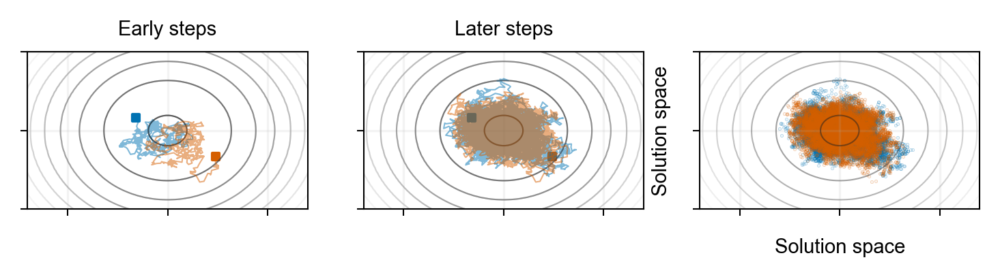

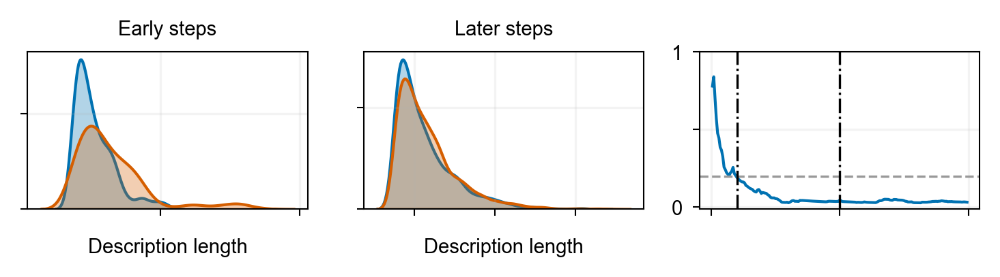

In [16]:
start_pos = np.array([
    [-1.5, 1.0],
    [2.5, -1.5],
    [0.0, -0.0],
])

log_prob = lambda coords: ln_prob_unimodal(coords)

jump_size = 0.15
moves = emcee.moves.GaussianMove(cov=np.eye(n_dim) * jump_size**2)
sampler = emcee.EnsembleSampler(n_walkers, n_dim, log_prob, moves=moves)
_ = sampler.run_mcmc(start_pos, n_steps)
chains = sampler.get_chain()
dls = -sampler.get_log_prob()

fig = plot_simulations(chains, time_slices_sim, log_prob, levels=10)
fig.savefig(f'{folder}/modes-uni_converged-yes_desc-traces.svg', transparent=True, dpi=300, bbox_inches='tight')

fig = plot_ksd(dls, time_slices_ksd, log_prob)
fig.savefig(f'{folder}/modes-uni_converged-yes_desc-ksd.svg', transparent=True, dpi=300, bbox_inches='tight')

In [17]:
mcmc_traces = []
mcmc_surfaces = []
cscales = ['Blues', 'Oranges']
for idx_chain in range(2):
    x, y = chains[::50, idx_chain, 0], chains[::50, idx_chain, 1]
    
    xy = np.vstack([x, y])
    kde = gaussian_kde(xy, bw_method='scott')
    
    xmin, xmax = x.min() - 3.0, x.max() + 3.0
    ymin, ymax = y.min() - 3.0, y.max() + 3.0
    xgrid, ygrid = np.mgrid[xmin:xmax:500j, ymin:ymax:500j]
    grid_coords = np.vstack([xgrid.ravel(), ygrid.ravel()])
    z = kde(grid_coords).reshape(xgrid.shape)
    
    vert_exag = 2.0
    z_plot = ((z - z.min()) / (z.max() - z.min() + 1e-12)) ** 0.8 * vert_exag
    
    z_floor = z_plot.min()
    z = np.full_like(x, z_floor)
    
    mcmc_traces += [
        go.Scatter3d(
            x=x, y=y, z=z,
            mode='lines',
            line=dict(color=CUD_COLORS[idx_chain], width=3),
            name=f'Walker {idx_chain}',
        )
    ]
    
    mcmc_surfaces += [
        go.Surface(
            x=xgrid, y=ygrid, z=z_plot,
            colorscale=cscales[idx_chain],
            opacity=1.0,
            showscale=False,
            lighting=dict(ambient=1.0, diffuse=0.0, specular=0.0, roughness=1.0, fresnel=0.0)  # flat, no glints
        )
    ]
    
fig = go.Figure(data=mcmc_surfaces) # + mcmc_traces)
fig.update_layout(
    width=200, height=155,
    scene=dict(
        xaxis=dict(visible=False), yaxis=dict(visible=False), zaxis=dict(visible=False),
        aspectratio=dict(x=1, y=1, z=vert_exag/4),  # tweak z feel independent of data scale
        bgcolor='white',
        camera=dict(eye=dict(x=1.6, y=1.6, z=1.2))
    ),
    margin=dict(l=0, r=0, t=0, b=0)
)
fig.write_image(f'{folder}/modes-uni_converged-yes_desc-trace-density.svg')
fig.show()

multi-modal landscape: convergent

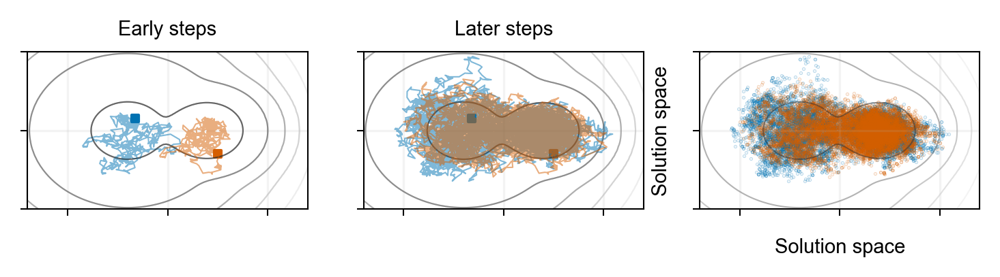

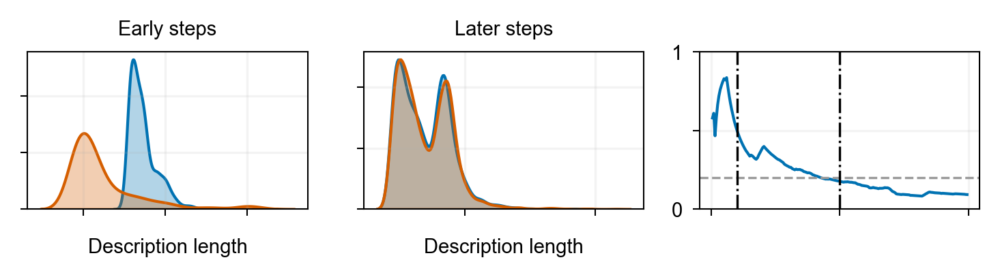

In [18]:
start_pos = np.array([
    [-1.5, 1.0],
    [2.5, -1.5],
    [0.0, -0.0],
])

log_prob = lambda coords: ln_prob_bimodal_convergent(coords)

jump_size = 0.2
moves = emcee.moves.GaussianMove(cov=np.eye(n_dim) * jump_size**2)
sampler = emcee.EnsembleSampler(n_walkers, n_dim, log_prob, moves=moves)
_ = sampler.run_mcmc(start_pos, n_steps)
chains = sampler.get_chain()
dls = -sampler.get_log_prob()

fig = plot_simulations(chains, time_slices_sim, log_prob, levels=10)
fig.savefig(f'{folder}/modes-multi_converged-yes_desc-traces.svg', transparent=True, dpi=300, bbox_inches='tight')

fig = plot_ksd(dls, time_slices_ksd, log_prob)
fig.savefig(f'{folder}/modes-multi_converged-yes_desc-ksd.svg', transparent=True, dpi=300, bbox_inches='tight')

In [19]:
mcmc_traces = []
mcmc_surfaces = []
cscales = ['Blues', 'Oranges']
for idx_chain in range(2):
    x, y = chains[::50, idx_chain, 0], chains[::50, idx_chain, 1]
    
    xy = np.vstack([x, y])
    kde = gaussian_kde(xy, bw_method='scott')
    
    xmin, xmax = x.min() - 3.0, x.max() + 3.0
    ymin, ymax = y.min() - 3.0, y.max() + 3.0
    xgrid, ygrid = np.mgrid[xmin:xmax:500j, ymin:ymax:500j]
    grid_coords = np.vstack([xgrid.ravel(), ygrid.ravel()])
    z = kde(grid_coords).reshape(xgrid.shape)
    
    vert_exag = 2.0
    z_plot = ((z - z.min()) / (z.max() - z.min() + 1e-12)) ** 0.8 * vert_exag
    
    z_floor = z_plot.min()
    z = np.full_like(x, z_floor)
    
    mcmc_traces += [
        go.Scatter3d(
            x=x, y=y, z=z,
            mode='lines',
            line=dict(color=CUD_COLORS[idx_chain], width=3),
            name=f'Walker {idx_chain}',
        )
    ]
    
    mcmc_surfaces += [
        go.Surface(
            x=xgrid, y=ygrid, z=z_plot,
            colorscale=cscales[idx_chain],
            opacity=1.0,
            showscale=False,
            lighting=dict(ambient=1.0, diffuse=0.0, specular=0.0, roughness=1.0, fresnel=0.0)  # flat, no glints
        )
    ]
    
fig = go.Figure(data=mcmc_surfaces) # + mcmc_traces)
fig.update_layout(
    width=200, height=155,
    scene=dict(
        xaxis=dict(visible=False), yaxis=dict(visible=False), zaxis=dict(visible=False),
        aspectratio=dict(x=1, y=1, z=vert_exag/4),  # tweak z feel independent of data scale
        bgcolor='white',
        camera=dict(eye=dict(x=1.6, y=1.6, z=1.2))
    ),
    margin=dict(l=0, r=0, t=0, b=0)
)
fig.write_image(f'{folder}/modes-multi_converged-yes_desc-trace-density.svg')
fig.show()

multi-modal landscape: divergent

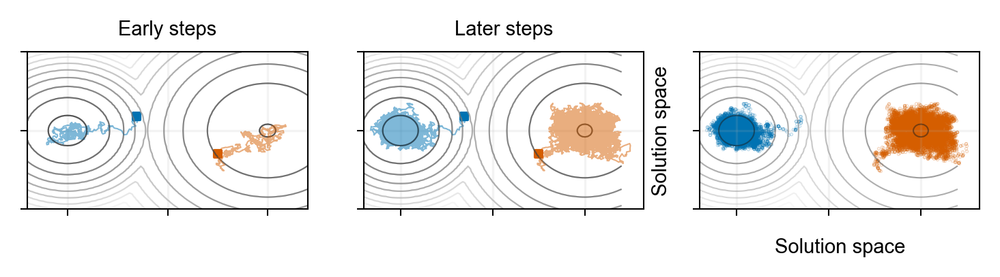

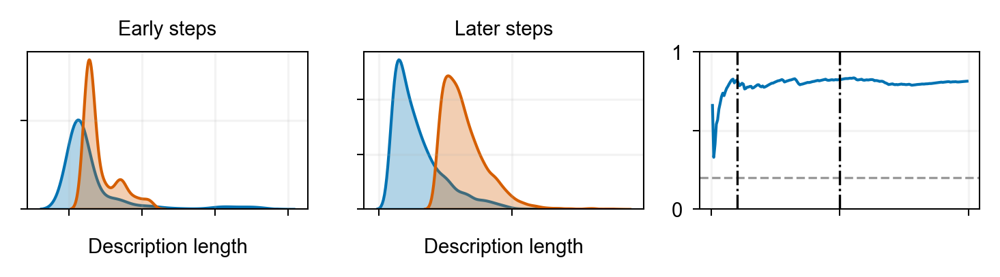

In [20]:
start_pos = np.array([
    [-1.5, 1.0],
    [2.5, -1.5],
    [0.0, -0.0],
])

log_prob = lambda coords: ln_prob_bimodal_divergent(coords)

jump_size = 0.1
moves = emcee.moves.GaussianMove(cov=np.eye(n_dim) * jump_size**2)
sampler = emcee.EnsembleSampler(n_walkers, n_dim, log_prob, moves=moves)
_ = sampler.run_mcmc(start_pos, n_steps)
chains = sampler.get_chain()
dls = -sampler.get_log_prob()

fig = plot_simulations(chains, time_slices_sim, log_prob, levels=10)
fig.savefig(f'{folder}/modes-multi_converged-no_desc-traces.svg', transparent=True, dpi=300, bbox_inches='tight')

fig = plot_ksd(dls, time_slices_ksd, log_prob)
fig.savefig(f'{folder}/modes-multi_converged-no_desc-ksd.svg', transparent=True, dpi=300, bbox_inches='tight')

In [21]:
mcmc_traces = []
mcmc_surfaces = []
cscales = ['Blues', 'Oranges']
for idx_chain in range(2):
    x, y = chains[::50, idx_chain, 0], chains[::50, idx_chain, 1]
    
    xy = np.vstack([x, y])
    kde = gaussian_kde(xy, bw_method='scott')
    
    xmin, xmax = x.min() - 3.0, x.max() + 3.0
    ymin, ymax = y.min() - 3.0, y.max() + 3.0
    xgrid, ygrid = np.mgrid[xmin:xmax:500j, ymin:ymax:500j]
    grid_coords = np.vstack([xgrid.ravel(), ygrid.ravel()])
    z = kde(grid_coords).reshape(xgrid.shape)
    
    vert_exag = 2.0
    z_plot = ((z - z.min()) / (z.max() - z.min() + 1e-12)) ** 0.8 * vert_exag
    
    z_floor = z_plot.min()
    z = np.full_like(x, z_floor)
    
    mcmc_traces += [
        go.Scatter3d(
            x=x, y=y, z=z,
            mode='lines',
            line=dict(color=CUD_COLORS[idx_chain], width=3),
            name=f'Walker {idx_chain}',
        )
    ]
    
    mcmc_surfaces += [
        go.Surface(
            x=xgrid, y=ygrid, z=z_plot,
            colorscale=cscales[idx_chain],
            opacity=1.0,
            showscale=False,
            lighting=dict(ambient=1.0, diffuse=0.0, specular=0.0, roughness=1.0, fresnel=0.0)  # flat, no glints
        )
    ]
    
fig = go.Figure(data=mcmc_surfaces) # + mcmc_traces)
fig.update_layout(
    width=200, height=155,
    scene=dict(
        xaxis=dict(visible=False), yaxis=dict(visible=False), zaxis=dict(visible=False),
        aspectratio=dict(x=1, y=1, z=vert_exag/4),  # tweak z feel independent of data scale
        bgcolor='white',
        camera=dict(eye=dict(x=1.6, y=1.6, z=1.2))
    ),
    margin=dict(l=0, r=0, t=0, b=0)
)
fig.write_image(f'{folder}/modes-multi_converged-no_desc-trace-density.svg')
fig.show()